In [27]:
# Adapted from PyTorch tutorial 
# https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [11]:
dataroot = "./celebA/"

# Number of workers for dataloader
workers = 1

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

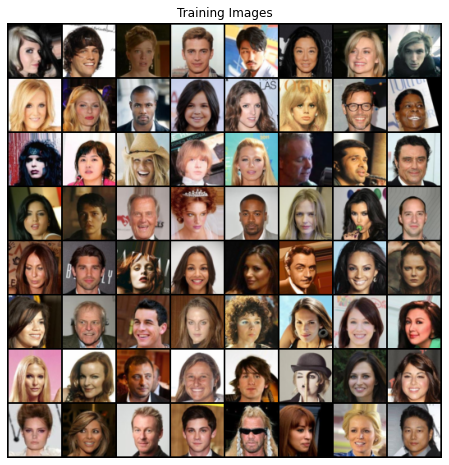

In [12]:
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [13]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [14]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [15]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [16]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [17]:
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [18]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [19]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/10][0/3166]	Loss_D: 1.6926	Loss_G: 2.4419	D(x): 0.3241	D(G(z)): 0.2646 / 0.1036
[0/10][50/3166]	Loss_D: 0.0079	Loss_G: 15.7408	D(x): 0.9935	D(G(z)): 0.0000 / 0.0000
[0/10][100/3166]	Loss_D: 0.0766	Loss_G: 32.0490	D(x): 0.9749	D(G(z)): 0.0000 / 0.0000
[0/10][150/3166]	Loss_D: 0.7954	Loss_G: 8.5362	D(x): 0.8267	D(G(z)): 0.3293 / 0.0014
[0/10][200/3166]	Loss_D: 0.7359	Loss_G: 4.3983	D(x): 0.5936	D(G(z)): 0.0075 / 0.0303
[0/10][250/3166]	Loss_D: 1.3170	Loss_G: 7.7038	D(x): 0.4515	D(G(z)): 0.0030 / 0.0014
[0/10][300/3166]	Loss_D: 1.2043	Loss_G: 5.3147	D(x): 0.4605	D(G(z)): 0.0047 / 0.0120
[0/10][350/3166]	Loss_D: 0.9657	Loss_G: 6.3655	D(x): 0.8420	D(G(z)): 0.4367 / 0.0037
[0/10][400/3166]	Loss_D: 0.7205	Loss_G: 6.1335	D(x): 0.9006	D(G(z)): 0.4157 / 0.0048
[0/10][450/3166]	Loss_D: 0.2660	Loss_G: 4.0179	D(x): 0.8779	D(G(z)): 0.0855 / 0.0340
[0/10][500/3166]	Loss_D: 0.6418	Loss_G: 3.4246	D(x): 0.7316	D(G(z)): 0.1384 / 0.0625
[0/10][550/3166]	Loss_D: 0.9271	Loss_G: 

[1/10][1600/3166]	Loss_D: 0.6235	Loss_G: 4.8110	D(x): 0.9403	D(G(z)): 0.3961 / 0.0105
[1/10][1650/3166]	Loss_D: 1.1209	Loss_G: 0.9540	D(x): 0.4124	D(G(z)): 0.0321 / 0.4432
[1/10][1700/3166]	Loss_D: 0.5741	Loss_G: 2.9364	D(x): 0.7650	D(G(z)): 0.2234 / 0.0699
[1/10][1750/3166]	Loss_D: 0.4493	Loss_G: 2.7205	D(x): 0.7252	D(G(z)): 0.0699 / 0.0907
[1/10][1800/3166]	Loss_D: 0.4546	Loss_G: 3.3422	D(x): 0.8111	D(G(z)): 0.1816 / 0.0476
[1/10][1850/3166]	Loss_D: 0.3910	Loss_G: 3.1476	D(x): 0.7542	D(G(z)): 0.0736 / 0.0613
[1/10][1900/3166]	Loss_D: 1.0142	Loss_G: 0.7248	D(x): 0.4813	D(G(z)): 0.0819 / 0.5423
[1/10][1950/3166]	Loss_D: 1.3308	Loss_G: 1.7723	D(x): 0.3254	D(G(z)): 0.0340 / 0.2380
[1/10][2000/3166]	Loss_D: 0.5094	Loss_G: 2.1197	D(x): 0.7579	D(G(z)): 0.1666 / 0.1535
[1/10][2050/3166]	Loss_D: 0.7764	Loss_G: 2.9022	D(x): 0.7968	D(G(z)): 0.3745 / 0.0735
[1/10][2100/3166]	Loss_D: 0.5499	Loss_G: 3.1178	D(x): 0.8652	D(G(z)): 0.3059 / 0.0567
[1/10][2150/3166]	Loss_D: 1.1903	Loss_G: 4.5873	D(x): 

[3/10][0/3166]	Loss_D: 0.2946	Loss_G: 3.3471	D(x): 0.9226	D(G(z)): 0.1752 / 0.0459
[3/10][50/3166]	Loss_D: 1.0585	Loss_G: 5.2514	D(x): 0.8656	D(G(z)): 0.5404 / 0.0085
[3/10][100/3166]	Loss_D: 0.5658	Loss_G: 2.8317	D(x): 0.6851	D(G(z)): 0.0991 / 0.0839
[3/10][150/3166]	Loss_D: 0.4972	Loss_G: 2.5663	D(x): 0.8293	D(G(z)): 0.2224 / 0.1027
[3/10][200/3166]	Loss_D: 1.9895	Loss_G: 6.5865	D(x): 0.9788	D(G(z)): 0.7815 / 0.0047
[3/10][250/3166]	Loss_D: 0.4958	Loss_G: 3.0838	D(x): 0.8825	D(G(z)): 0.2680 / 0.0657
[3/10][300/3166]	Loss_D: 0.4585	Loss_G: 3.9079	D(x): 0.9208	D(G(z)): 0.2810 / 0.0296
[3/10][350/3166]	Loss_D: 0.7549	Loss_G: 5.1750	D(x): 0.9714	D(G(z)): 0.4685 / 0.0096
[3/10][400/3166]	Loss_D: 0.3290	Loss_G: 2.9002	D(x): 0.8597	D(G(z)): 0.1332 / 0.0663
[3/10][450/3166]	Loss_D: 0.6924	Loss_G: 1.8540	D(x): 0.5923	D(G(z)): 0.0509 / 0.2161
[3/10][500/3166]	Loss_D: 0.3057	Loss_G: 3.3166	D(x): 0.8289	D(G(z)): 0.0904 / 0.0527
[3/10][550/3166]	Loss_D: 0.6169	Loss_G: 1.4460	D(x): 0.6360	D(G(z)):

[4/10][1600/3166]	Loss_D: 0.4279	Loss_G: 2.3703	D(x): 0.7844	D(G(z)): 0.1210 / 0.1265
[4/10][1650/3166]	Loss_D: 0.5211	Loss_G: 2.8448	D(x): 0.6817	D(G(z)): 0.0497 / 0.0965
[4/10][1700/3166]	Loss_D: 0.4372	Loss_G: 2.9215	D(x): 0.7390	D(G(z)): 0.0827 / 0.0781
[4/10][1750/3166]	Loss_D: 0.3696	Loss_G: 2.3895	D(x): 0.7788	D(G(z)): 0.0776 / 0.1332
[4/10][1800/3166]	Loss_D: 1.2205	Loss_G: 5.7425	D(x): 0.9815	D(G(z)): 0.6103 / 0.0057
[4/10][1850/3166]	Loss_D: 0.3258	Loss_G: 3.0720	D(x): 0.8932	D(G(z)): 0.1615 / 0.0694
[4/10][1900/3166]	Loss_D: 0.4807	Loss_G: 3.0030	D(x): 0.7588	D(G(z)): 0.1345 / 0.0784
[4/10][1950/3166]	Loss_D: 1.8377	Loss_G: 7.8672	D(x): 0.9577	D(G(z)): 0.7686 / 0.0009
[4/10][2000/3166]	Loss_D: 0.5025	Loss_G: 2.4068	D(x): 0.7154	D(G(z)): 0.0856 / 0.1305
[4/10][2050/3166]	Loss_D: 0.3604	Loss_G: 2.7841	D(x): 0.8272	D(G(z)): 0.1172 / 0.0813
[4/10][2100/3166]	Loss_D: 2.1952	Loss_G: 7.0008	D(x): 0.9934	D(G(z)): 0.8311 / 0.0021
[4/10][2150/3166]	Loss_D: 1.4402	Loss_G: 1.2686	D(x): 

[6/10][0/3166]	Loss_D: 0.3496	Loss_G: 4.8596	D(x): 0.9456	D(G(z)): 0.2234 / 0.0108
[6/10][50/3166]	Loss_D: 0.2564	Loss_G: 3.0713	D(x): 0.8569	D(G(z)): 0.0806 / 0.0709
[6/10][100/3166]	Loss_D: 0.4040	Loss_G: 5.2771	D(x): 0.9755	D(G(z)): 0.2789 / 0.0073
[6/10][150/3166]	Loss_D: 0.6249	Loss_G: 6.9346	D(x): 0.9887	D(G(z)): 0.3973 / 0.0013
[6/10][200/3166]	Loss_D: 0.2455	Loss_G: 3.1267	D(x): 0.8370	D(G(z)): 0.0505 / 0.0809
[6/10][250/3166]	Loss_D: 0.7263	Loss_G: 2.6720	D(x): 0.5643	D(G(z)): 0.0073 / 0.1162
[6/10][300/3166]	Loss_D: 0.8160	Loss_G: 8.8948	D(x): 0.9884	D(G(z)): 0.4845 / 0.0003
[6/10][350/3166]	Loss_D: 0.3457	Loss_G: 5.0608	D(x): 0.9641	D(G(z)): 0.2295 / 0.0094
[6/10][400/3166]	Loss_D: 0.6153	Loss_G: 5.7082	D(x): 0.9663	D(G(z)): 0.3813 / 0.0052
[6/10][450/3166]	Loss_D: 0.6878	Loss_G: 1.1518	D(x): 0.5942	D(G(z)): 0.0378 / 0.3967
[6/10][500/3166]	Loss_D: 0.5536	Loss_G: 6.1281	D(x): 0.9253	D(G(z)): 0.3270 / 0.0029
[6/10][550/3166]	Loss_D: 1.2900	Loss_G: 0.5420	D(x): 0.3734	D(G(z)):

[7/10][1600/3166]	Loss_D: 0.1655	Loss_G: 4.9878	D(x): 0.9876	D(G(z)): 0.1325 / 0.0093
[7/10][1650/3166]	Loss_D: 1.4920	Loss_G: 4.6051	D(x): 0.9346	D(G(z)): 0.6416 / 0.0251
[7/10][1700/3166]	Loss_D: 1.1612	Loss_G: 7.6881	D(x): 0.9765	D(G(z)): 0.6083 / 0.0008
[7/10][1750/3166]	Loss_D: 0.3242	Loss_G: 3.9369	D(x): 0.9006	D(G(z)): 0.1636 / 0.0267
[7/10][1800/3166]	Loss_D: 0.3642	Loss_G: 3.9908	D(x): 0.9322	D(G(z)): 0.2100 / 0.0324
[7/10][1850/3166]	Loss_D: 0.1742	Loss_G: 3.9468	D(x): 0.9456	D(G(z)): 0.1041 / 0.0281
[7/10][1900/3166]	Loss_D: 0.1471	Loss_G: 3.7684	D(x): 0.9124	D(G(z)): 0.0463 / 0.0466
[7/10][1950/3166]	Loss_D: 0.1528	Loss_G: 4.4136	D(x): 0.9677	D(G(z)): 0.1018 / 0.0186
[7/10][2000/3166]	Loss_D: 0.2046	Loss_G: 3.6450	D(x): 0.8704	D(G(z)): 0.0369 / 0.0484
[7/10][2050/3166]	Loss_D: 0.2573	Loss_G: 3.9187	D(x): 0.8958	D(G(z)): 0.1099 / 0.0343
[7/10][2100/3166]	Loss_D: 0.2361	Loss_G: 5.6554	D(x): 0.9875	D(G(z)): 0.1694 / 0.0054
[7/10][2150/3166]	Loss_D: 0.6479	Loss_G: 1.8972	D(x): 

[9/10][0/3166]	Loss_D: 0.1043	Loss_G: 4.8858	D(x): 0.9882	D(G(z)): 0.0836 / 0.0112
[9/10][50/3166]	Loss_D: 1.9053	Loss_G: 0.5586	D(x): 0.2466	D(G(z)): 0.0006 / 0.6550
[9/10][100/3166]	Loss_D: 2.0732	Loss_G: 1.3543	D(x): 0.2477	D(G(z)): 0.0144 / 0.3839
[9/10][150/3166]	Loss_D: 0.0674	Loss_G: 4.5649	D(x): 0.9762	D(G(z)): 0.0409 / 0.0189
[9/10][200/3166]	Loss_D: 0.1806	Loss_G: 4.5096	D(x): 0.9599	D(G(z)): 0.1151 / 0.0166
[9/10][250/3166]	Loss_D: 0.2437	Loss_G: 4.5681	D(x): 0.9397	D(G(z)): 0.1377 / 0.0184
[9/10][300/3166]	Loss_D: 0.1234	Loss_G: 4.7748	D(x): 0.9551	D(G(z)): 0.0691 / 0.0133
[9/10][350/3166]	Loss_D: 0.1608	Loss_G: 3.6893	D(x): 0.9846	D(G(z)): 0.1278 / 0.0363
[9/10][400/3166]	Loss_D: 0.0933	Loss_G: 3.8376	D(x): 0.9547	D(G(z)): 0.0425 / 0.0353
[9/10][450/3166]	Loss_D: 0.1119	Loss_G: 4.8132	D(x): 0.9786	D(G(z)): 0.0782 / 0.0156
[9/10][500/3166]	Loss_D: 0.9242	Loss_G: 4.0002	D(x): 0.7121	D(G(z)): 0.3280 / 0.0314
[9/10][550/3166]	Loss_D: 0.0967	Loss_G: 5.2770	D(x): 0.9395	D(G(z)):

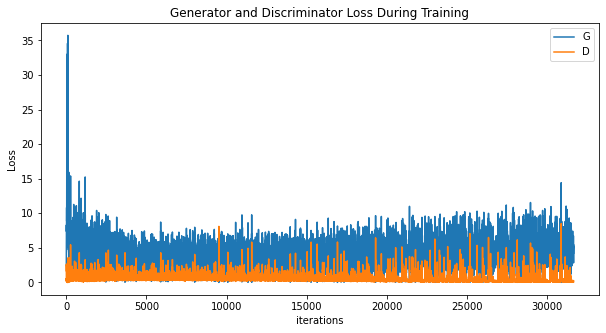

In [20]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21232529 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


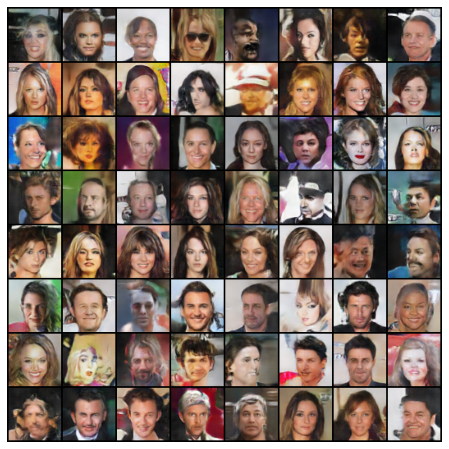

In [21]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

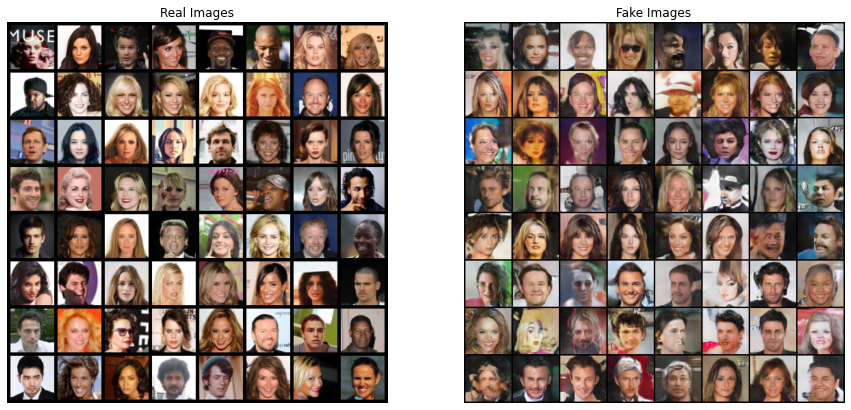

In [26]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

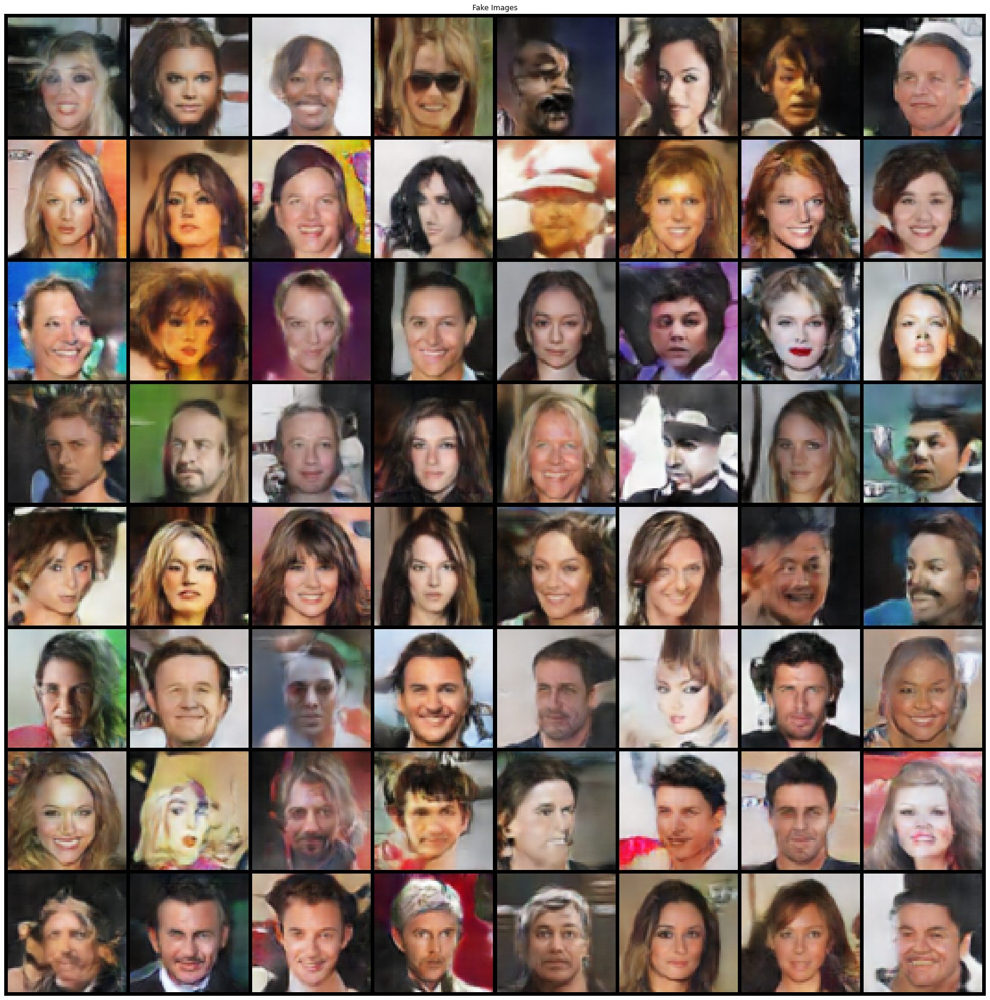

In [25]:
# Plot the fake images from the last epoch
plt.figure(figsize=(30,30))
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()